# Adative Median filter:

the adaptive median filter is a spatial filter designed to reduce noise while preserving edges and other significant details in an image. Unlike a standard median filter, which uses a fixed-size window, the adaptive median filter adjusts the window size based on local image statistics.

### Adaptive median filter's working steps:


1.   start with an initial window/kernel size, and define a maximum window size.
2.   calculate the following:


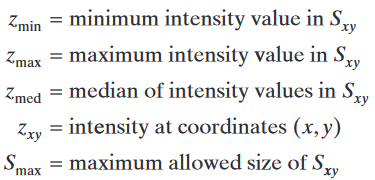


3. follow these choise rules to choose the pixel new values:

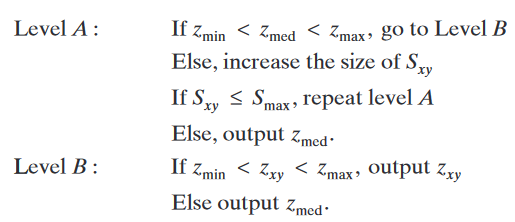

In [16]:
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import time
import numpy as np
import numpy as np
from scipy.ndimage import generic_filter
import numpy as np
from scipy.ndimage import convolve, median_filter

In [17]:
!pip install scipy

In [18]:
def adaptive_median_filter(img, kernel_size, max_kernel_size=7):
    filtered_img = np.copy(img)

    for cur_size in range(kernel_size, max_kernel_size + 1, 2):
        local_region = median_filter(img[:, :], size=cur_size, mode='reflect')

        z_min = np.min(local_region)
        z_max = np.max(local_region)
        z_med = np.median(local_region)

        if z_min < z_med < z_max:
            filtered_img[:, :] = np.where(
                (img[:, :] < z_min) | (img[:, :] > z_max), z_med, img[:, :]
            )
            break
        else:
            continue
    else:
        filtered_img[:, :] = z_med

    return filtered_img


Because the adaptive median filter processes the image pixel by pixel, its computational time is much bigger than other filters. Hence why I chose images with smaller sizes (and resolution), to showcase the filter behavior.


Some noise parameters and levels were changed to acomulate the new images.

In [32]:

image_folder = '/content/original_images'

data = []

for filename in os.listdir(image_folder):
    if filename.endswith(('.png', '.jpg', '.jpeg')):
        img = cv2.imread(os.path.join(image_folder, filename))
        if img is not None:
            # Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            data.append({'filename': filename, 'image': gray_img})

original = pd.DataFrame(data)

In [34]:
Computational_times = {}
average_MSE = {}
average_psnr = {}

# Salt and Pepper noise:

In [35]:
def add_salt_pepper_noise(image, prob):
    noisy_image = image.copy()

    num_salt = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 1

    num_pepper = np.ceil(prob * image.size * 0.5)
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in image.shape]
    noisy_image[coords[0], coords[1]] = 0

    return noisy_image

noise_levels = [0.01, 0.08, 0.2]

noisy_data = []

for index, row in original.iterrows():
    for level in noise_levels:
        noisy_img = add_salt_pepper_noise(row['image'], level)
        noisy_data.append({
            'filename': f"{row['filename']}_noise_{level}",
            'image': noisy_img,
            'noise_level': level
        })


salty = pd.DataFrame(noisy_data)

In [36]:
Computational_times["Salt and Pepper"] = []
average_MSE["Salt and Pepper"] = []
average_psnr["Salt and Pepper"] = []

In [37]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 0.8547 seconds


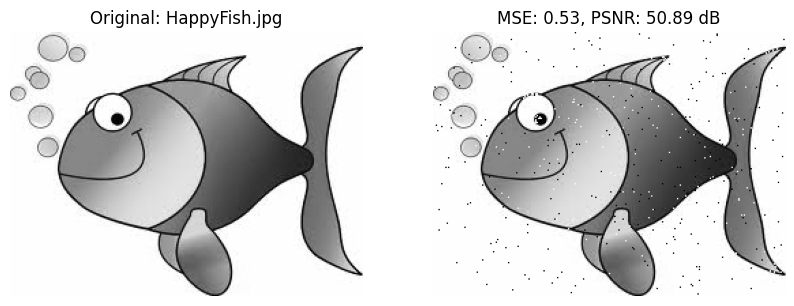

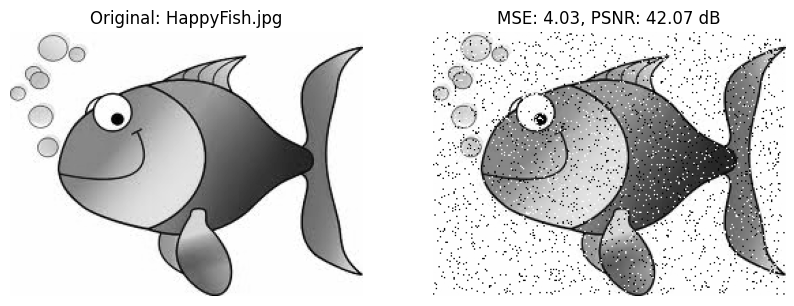

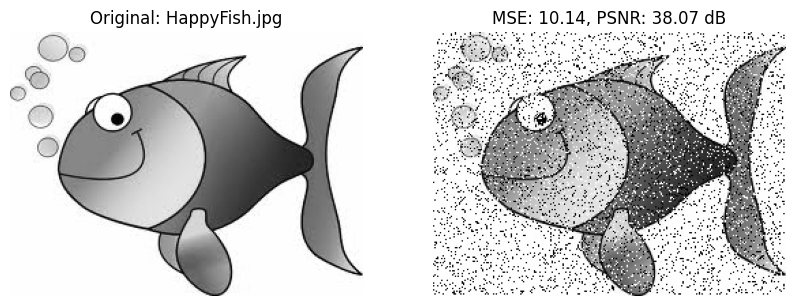

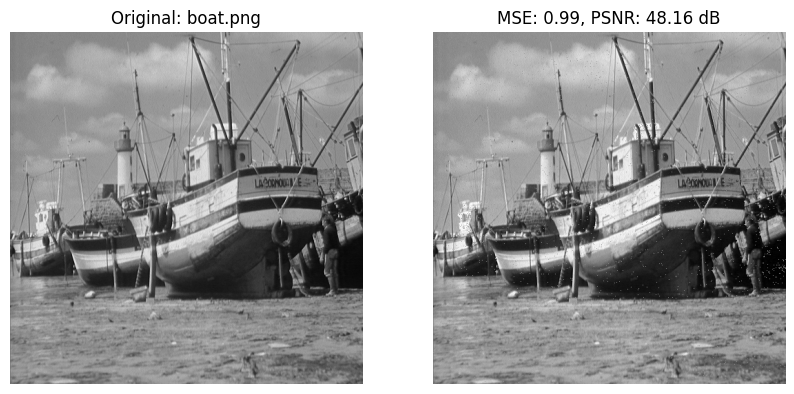

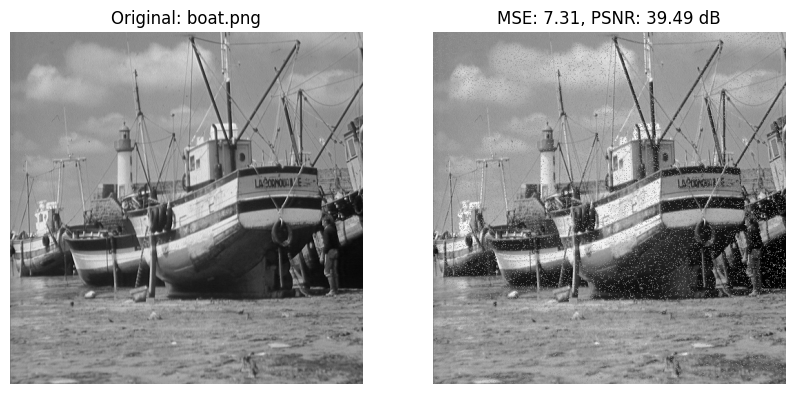

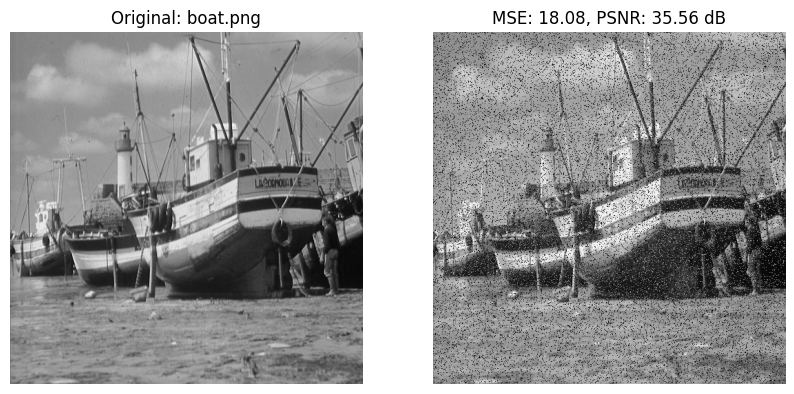

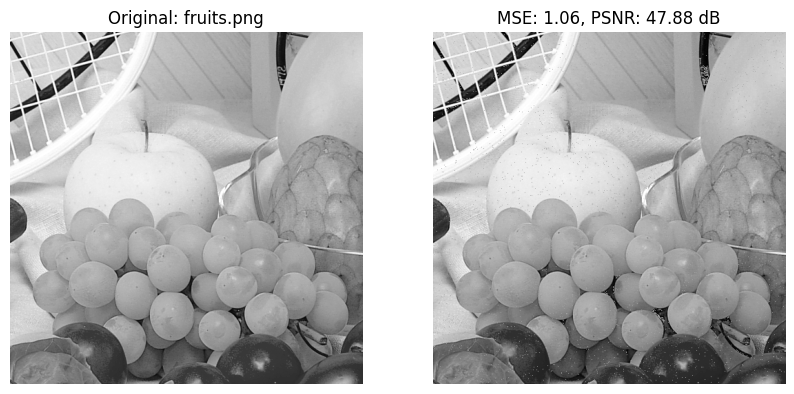

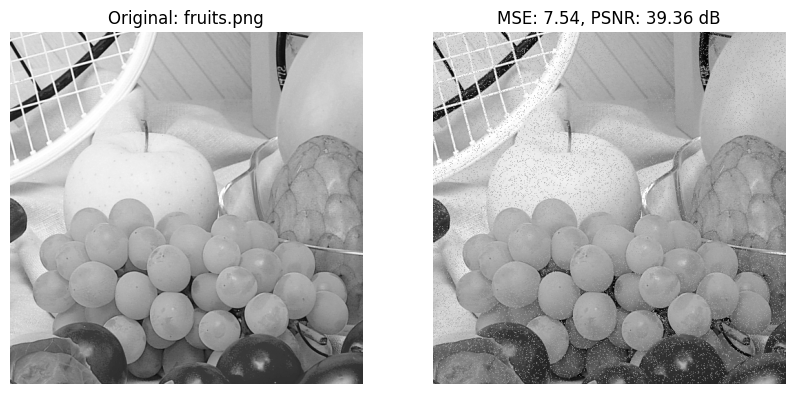

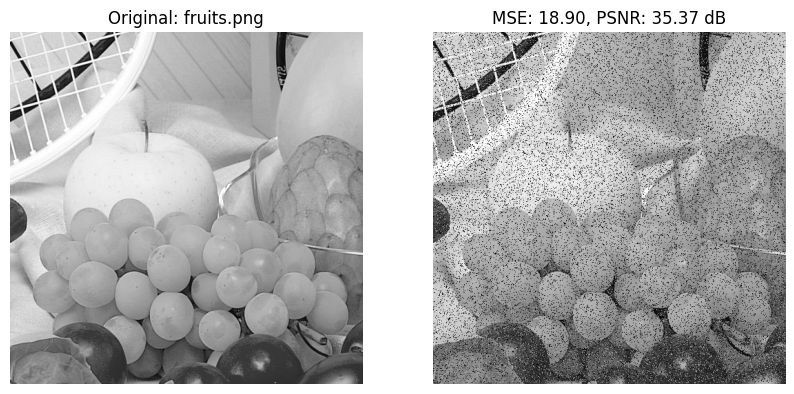

avarage mse = 7.6191990224279005
avarage psnr = 41.87349178387001


In [38]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

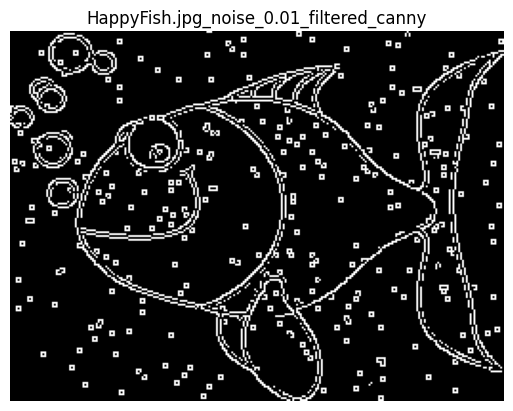

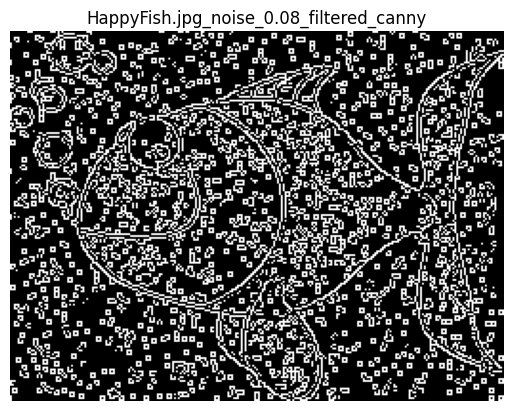

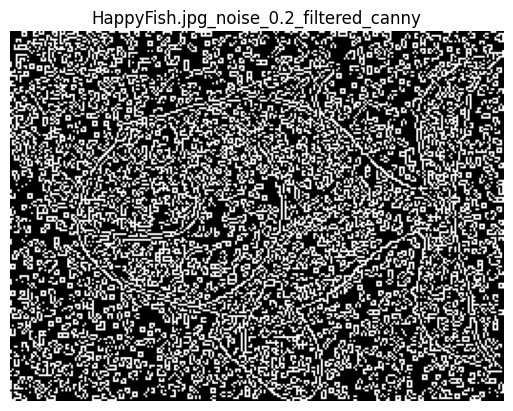

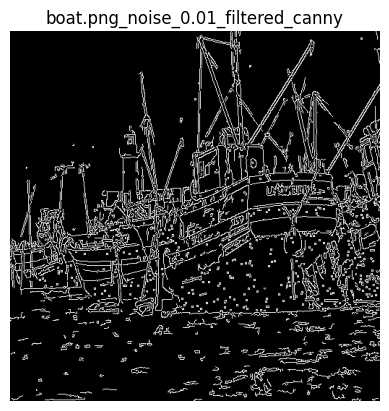

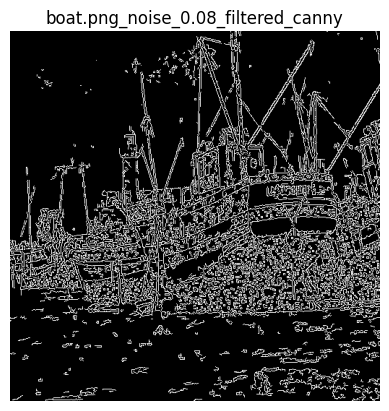

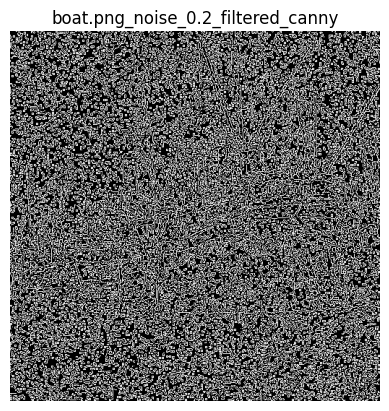

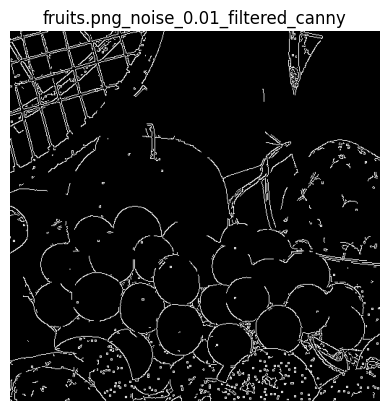

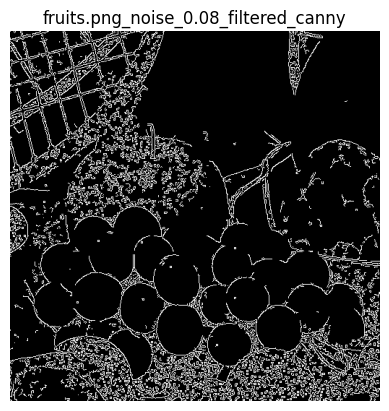

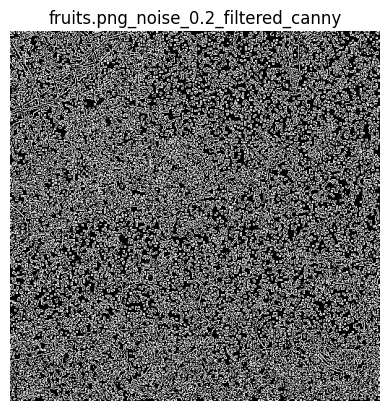

In [39]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

As the adaptive median filter is built of a normal median filter, it does well against salt and pepper noise (noise with a lot of outliers), while paying more attention to details and edges.




As noticed in previous outputs, the filter removed most of the noise from images with low and medium levels of noise, while keeping the edges and details well preserved. The skeleton of the objects was still clear in both cases.




However, it's not perfect. As it failed to remove noise from images with high levels of noise.

In [40]:
start_time = time.time()

filtered_data = []

for index, row in salty.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Salt and Pepper"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 3.4456 seconds


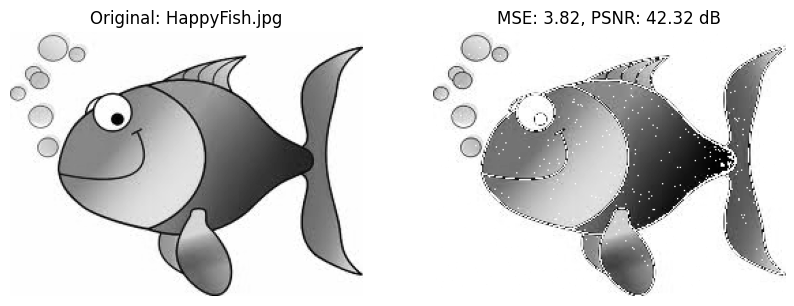

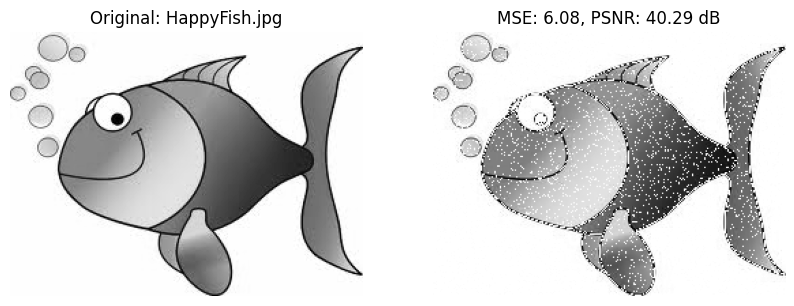

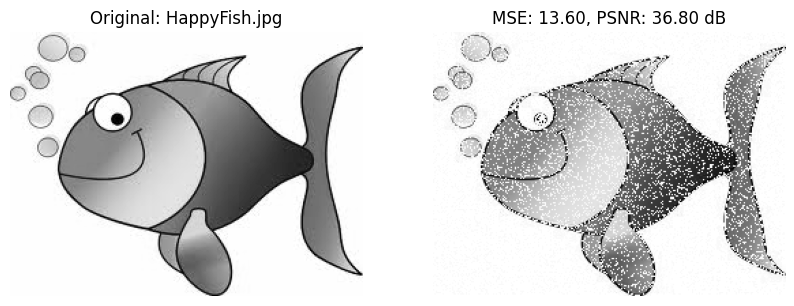

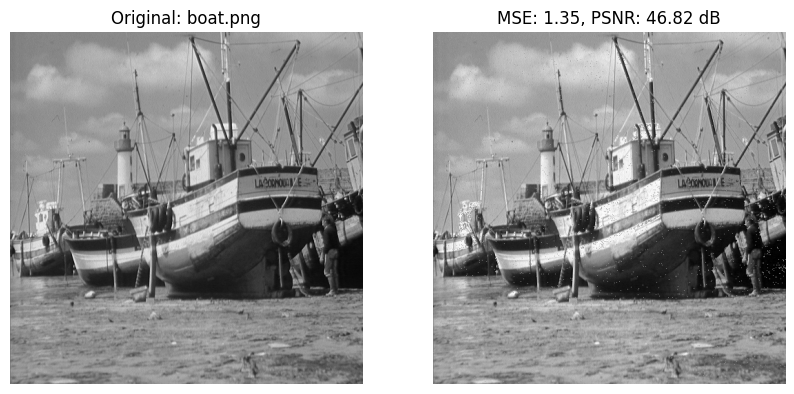

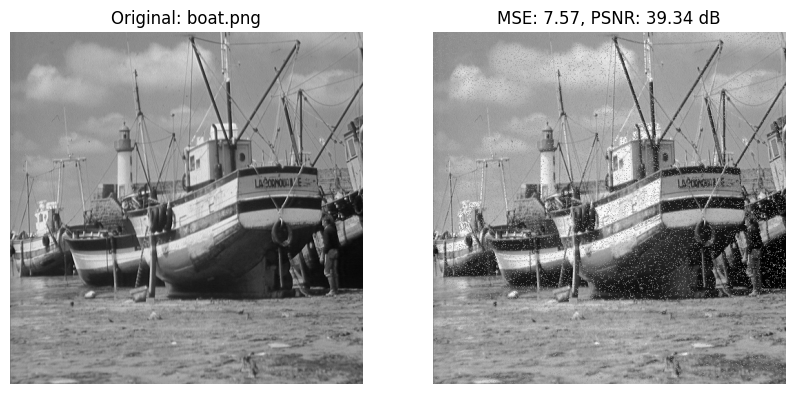

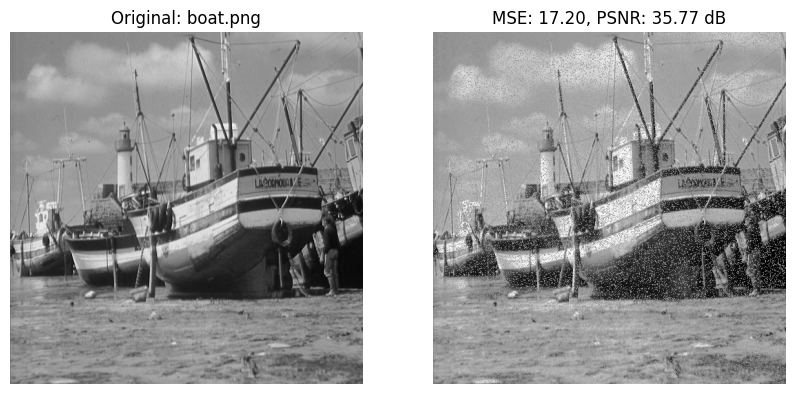

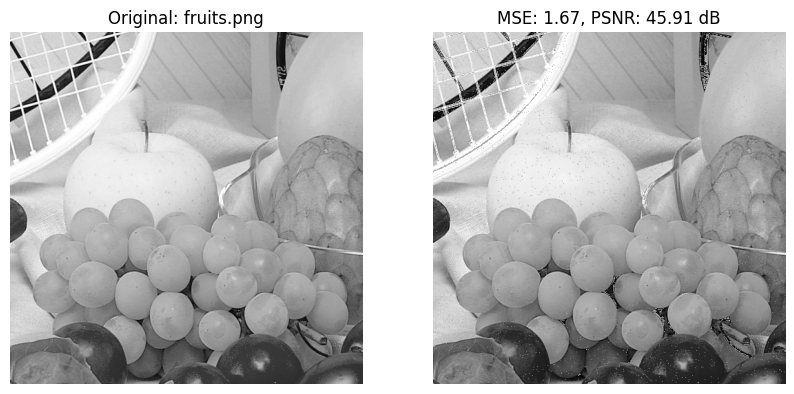

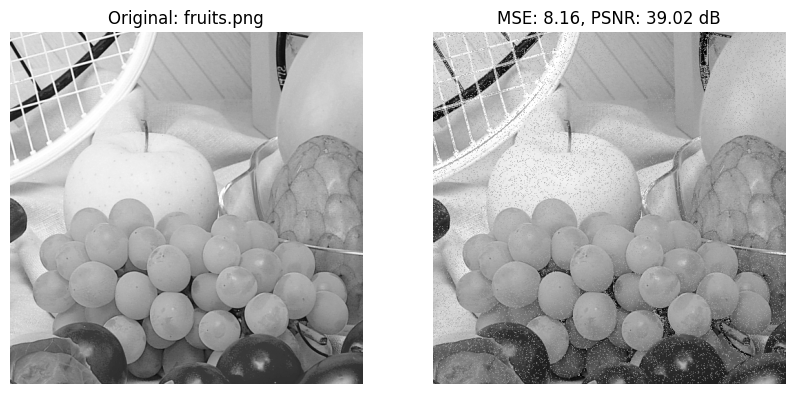

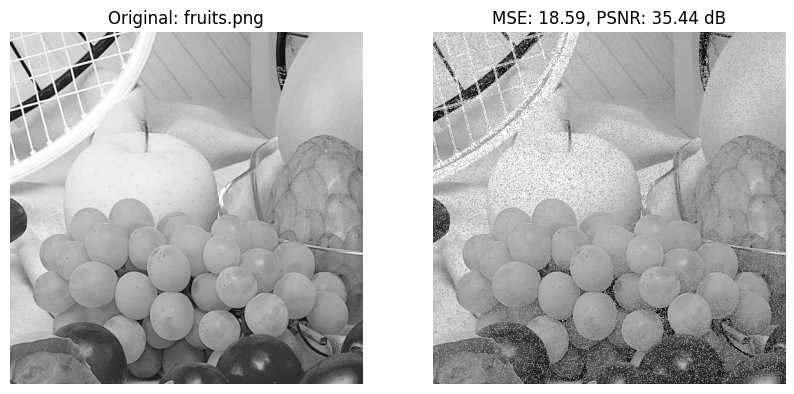

avarage mse = 8.6710424287025
avarage psnr = 40.18884631371222


In [41]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Salt and Pepper"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Salt and Pepper"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

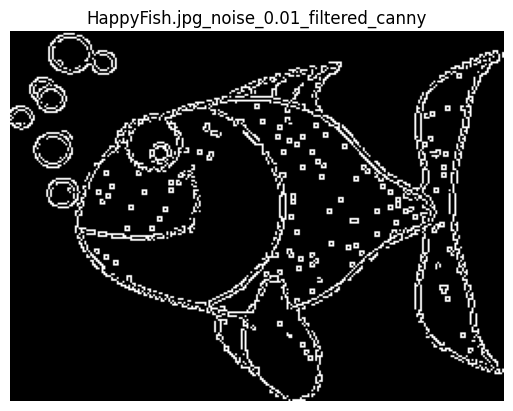

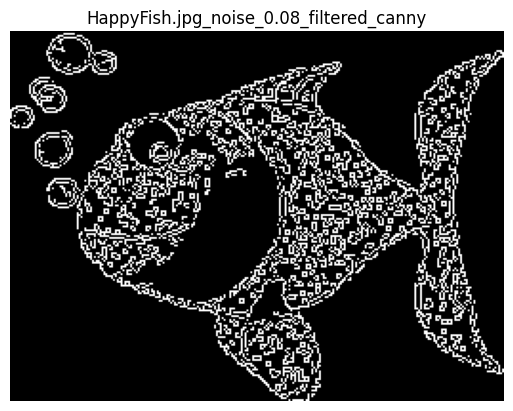

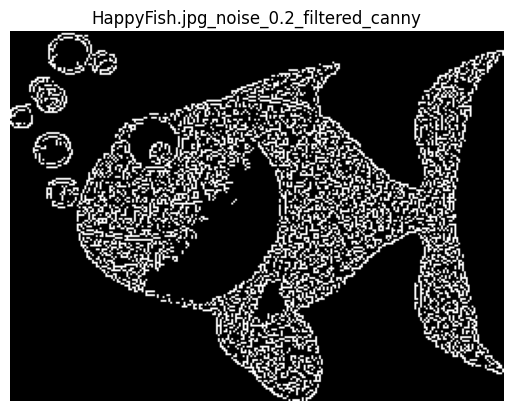

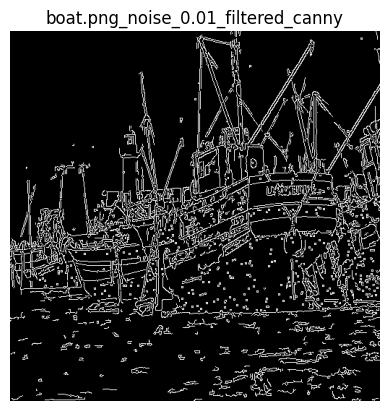

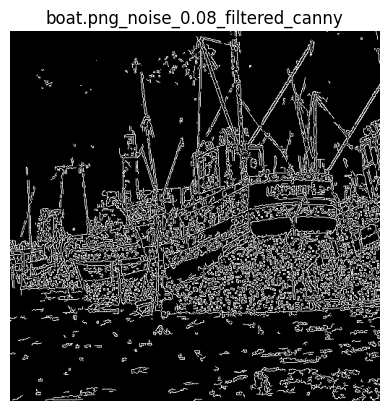

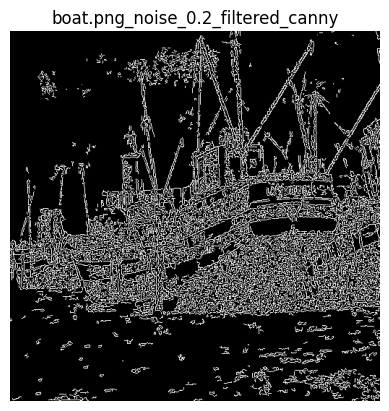

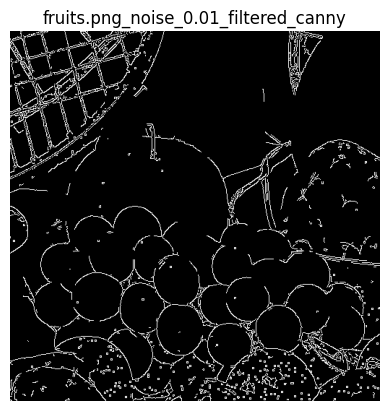

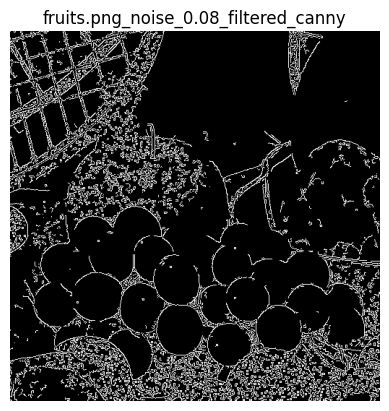

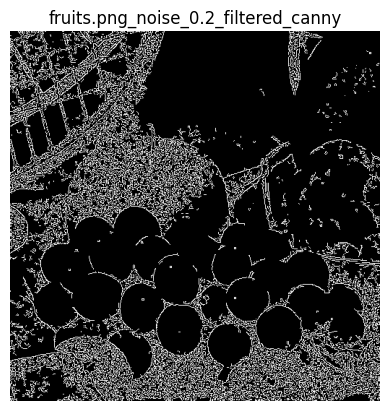

In [42]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Increasing the kernel size and the maximum kernel size increased the filter effect, and gave it more freedom to work with the images' true needs.


This time it was able to remove noise even from images with high levels of noise. And Canny could still detect the objects as skeletons, even if it detected some noise as edges in more noisy images.

# Gaussian noise:

In [60]:
def add_gaussian_noise(image, var, mean=20):
    sigma = var**0.5
    gaussian_noise = np.random.normal(mean, sigma, image.shape)

    noisy_image = image + gaussian_noise

    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)

    return noisy_image

gaussian_variances = [50, 100, 200]

noisy_data_gaussian = []

for index, row in original.iterrows():
    for var in gaussian_variances:
        noisy_img = add_gaussian_noise(row['image'], var=var)
        noisy_data_gaussian.append({
            'filename': f"{row['filename']}_gaussian_{var}",
            'image': noisy_img,
            'variance': var
        })

gaussian_noise = pd.DataFrame(noisy_data_gaussian)

In [68]:
Computational_times["Gaussian"] = []
average_MSE["Gaussian"] = []
average_psnr["Gaussian"] = []

In [69]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 0.9772 seconds


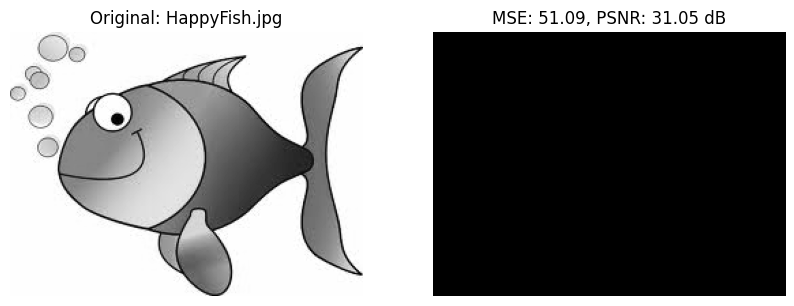

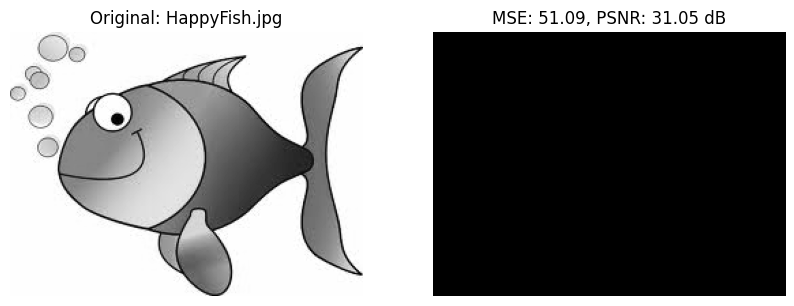

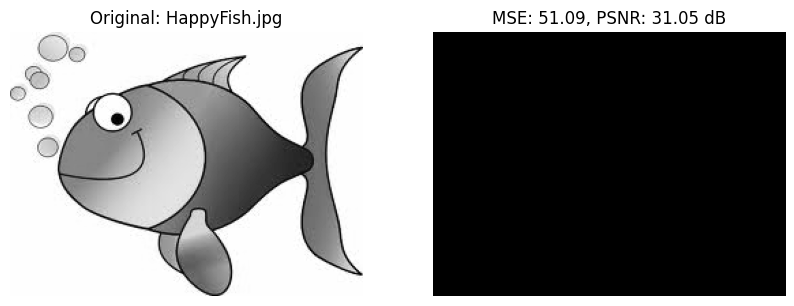

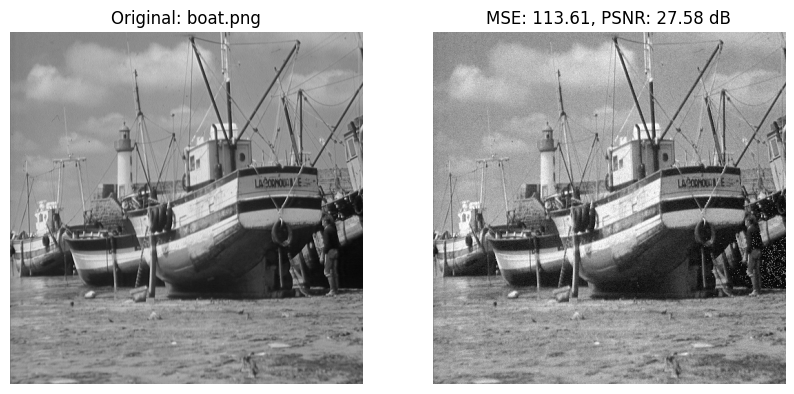

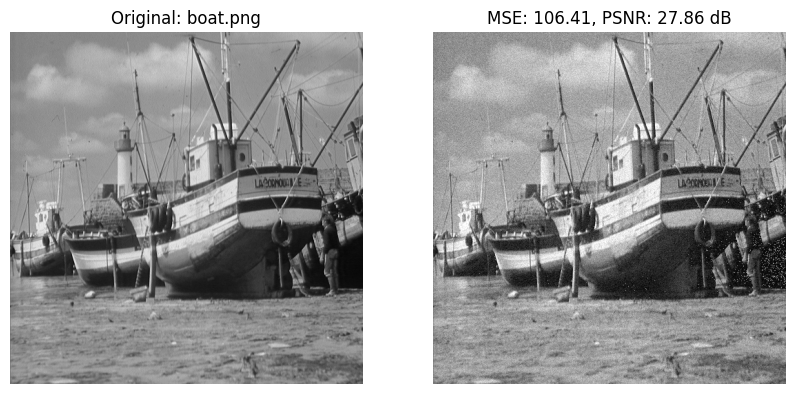

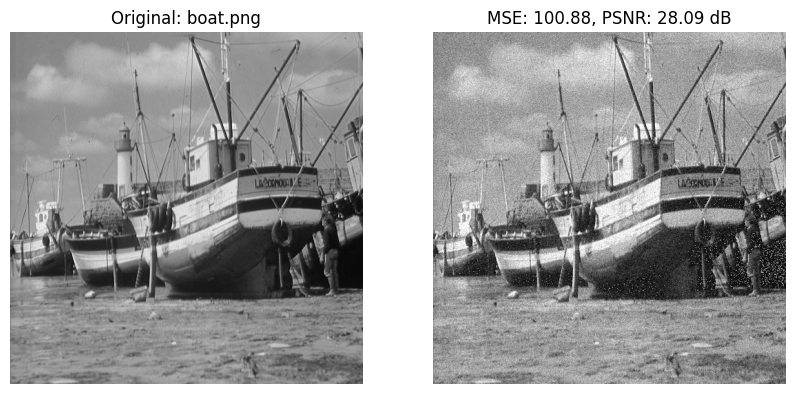

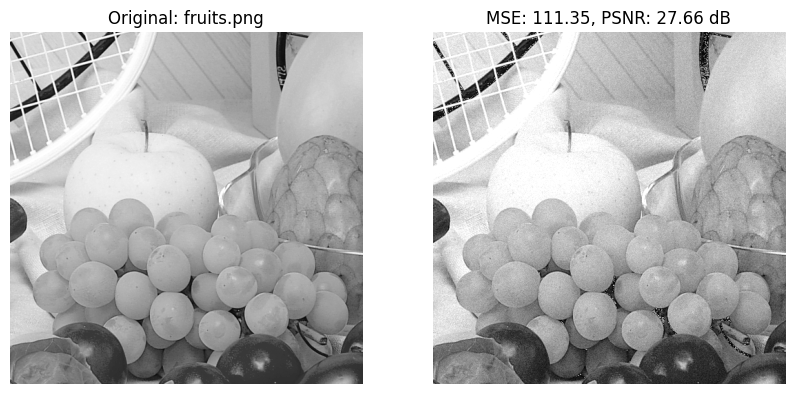

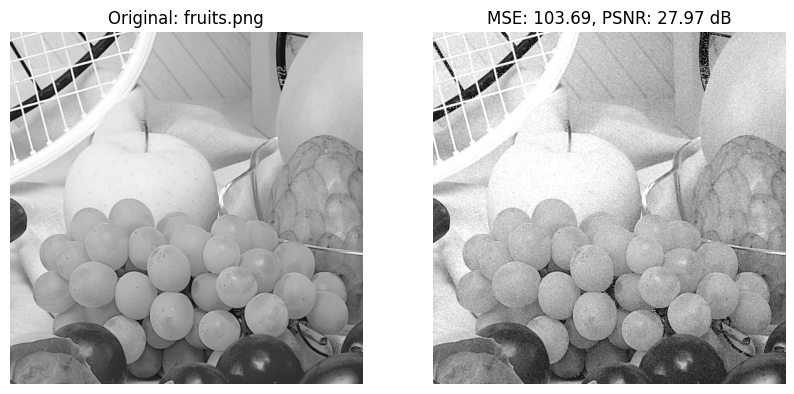

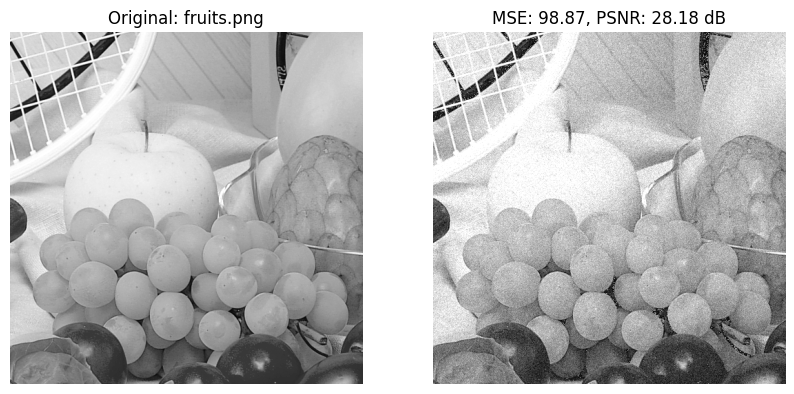

avarage mse = 87.5645197242455
avarage psnr = 28.94335207066809


In [70]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

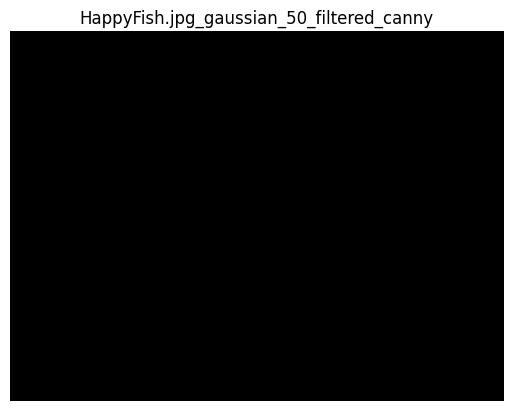

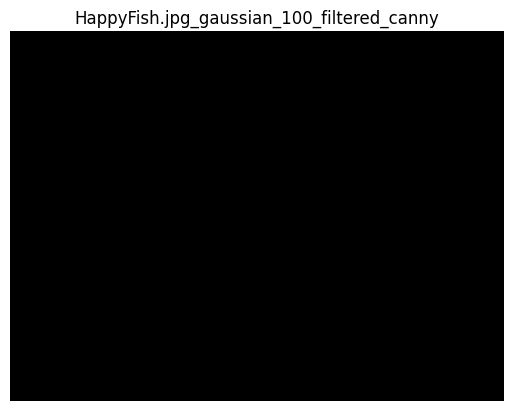

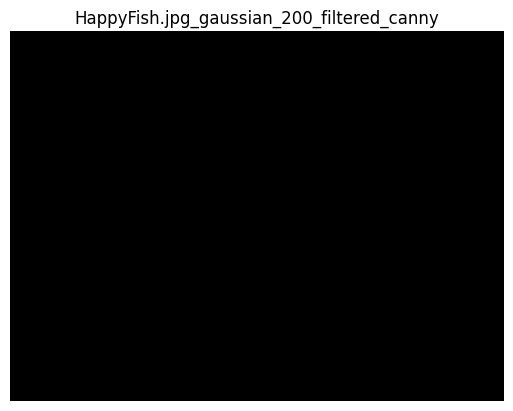

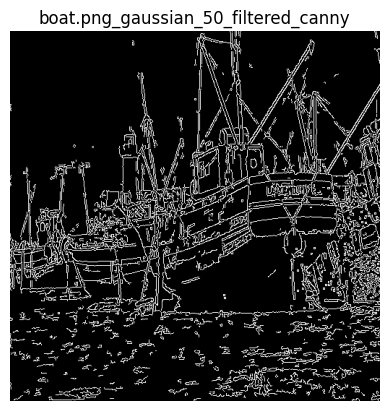

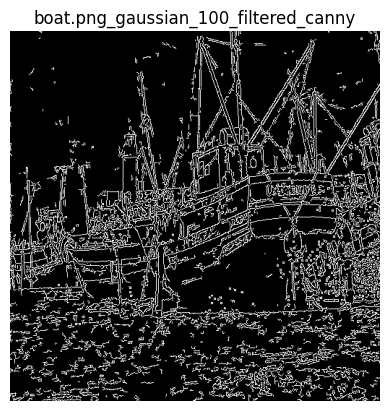

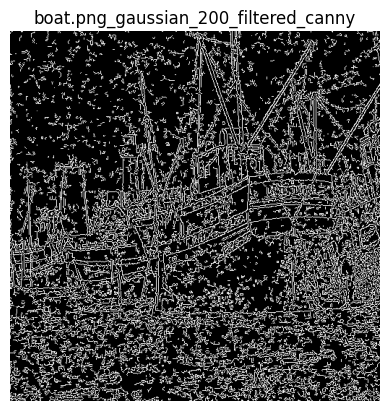

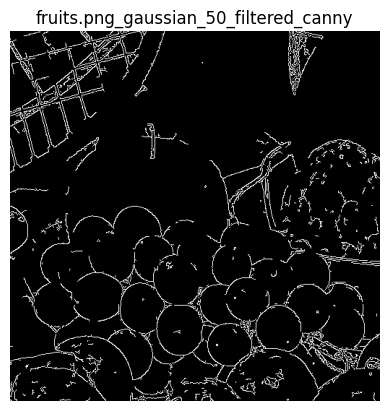

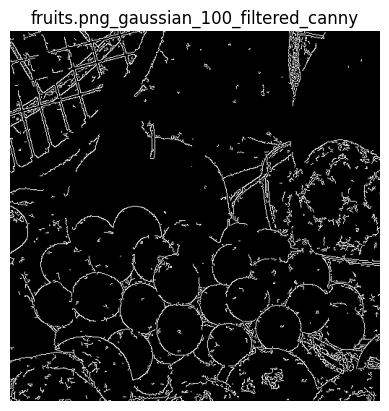

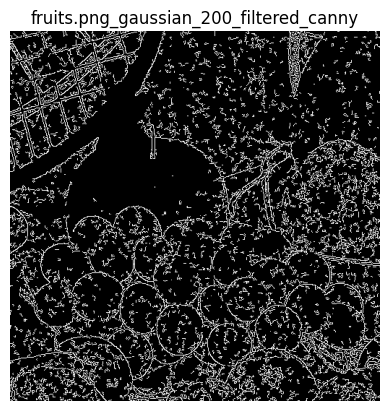

In [71]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Gaussian noise is much different from salt and pepper noise, as it may not contain as much outliers. The adaptive filter could still work well with it. Removing most of the noise while keeping the edges preserved.




Even in images with high levels of noise, the edges could still be seen in Canny's output. Although, with too much noise.

In [72]:
start_time = time.time()

filtered_data = []

for index, row in gaussian_noise.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Gaussian"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 4.0394 seconds


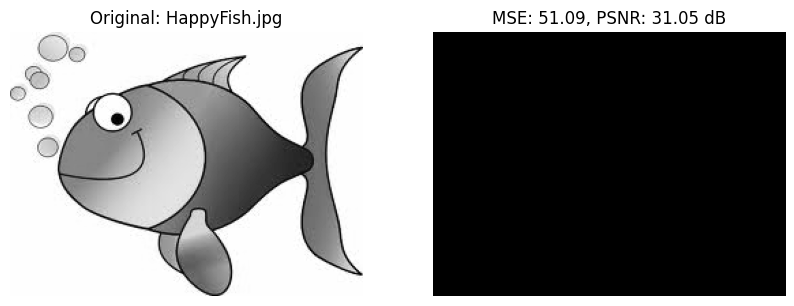

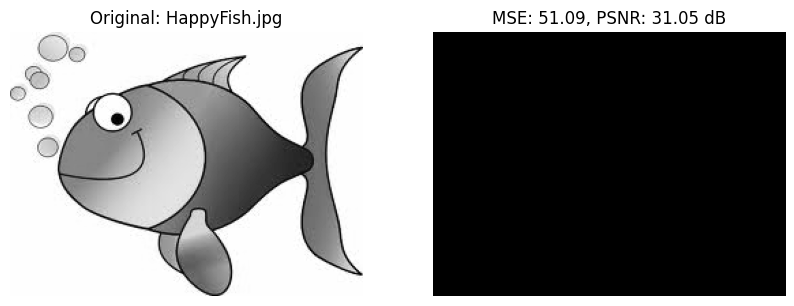

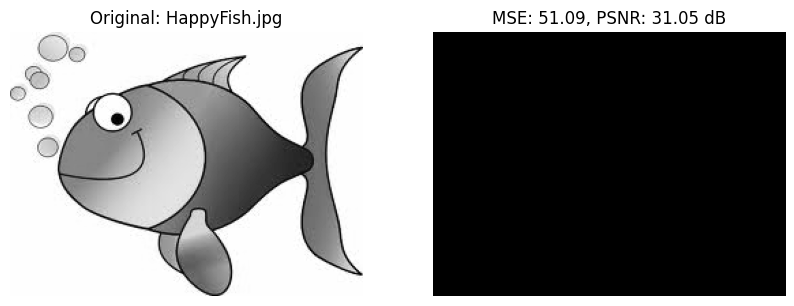

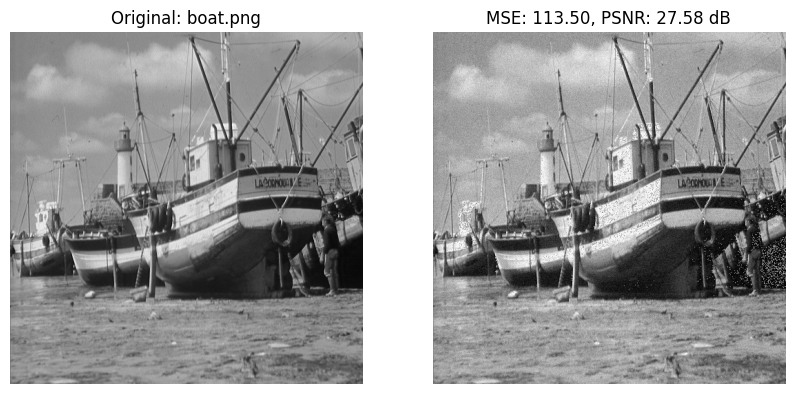

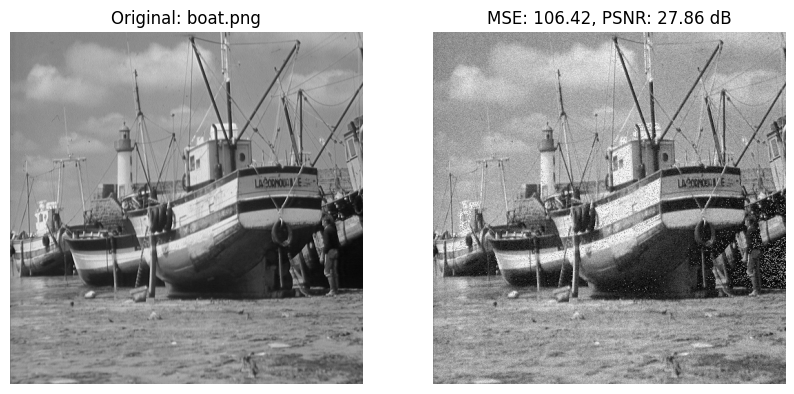

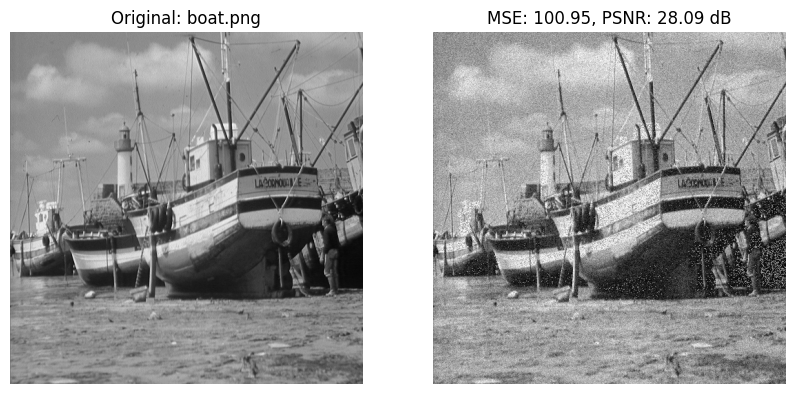

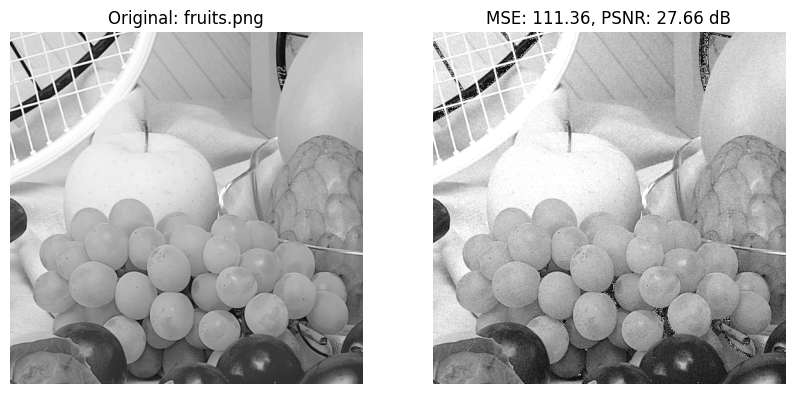

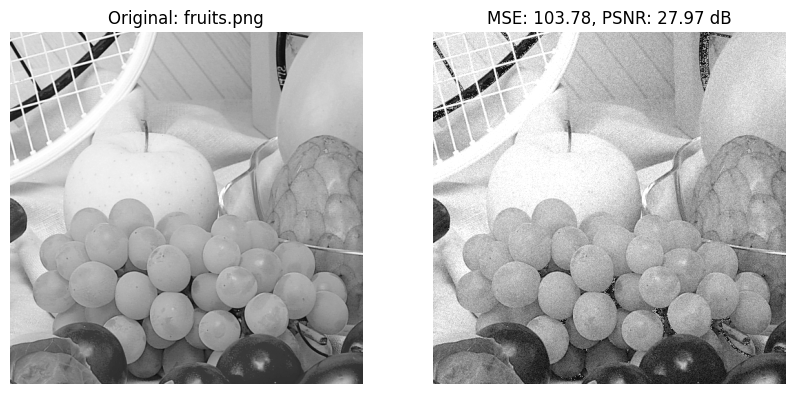

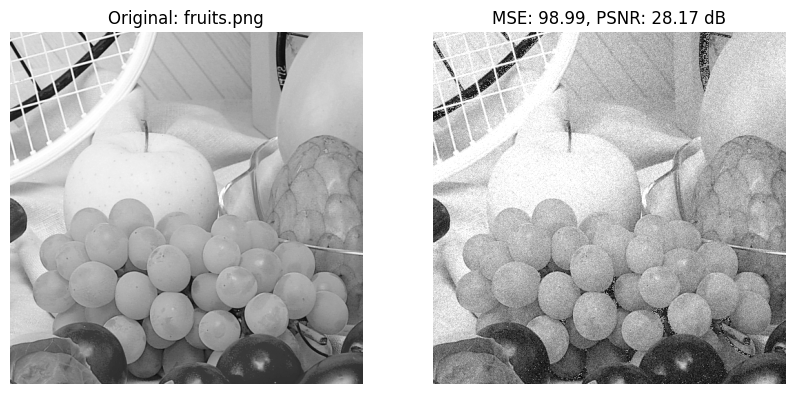

avarage mse = 87.58599858912723
avarage psnr = 28.94237770759715


In [73]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Gaussian"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Gaussian"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

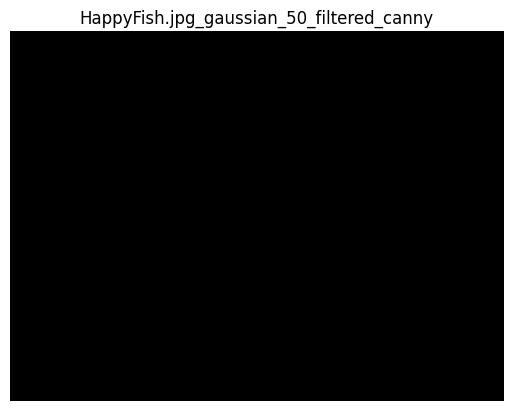

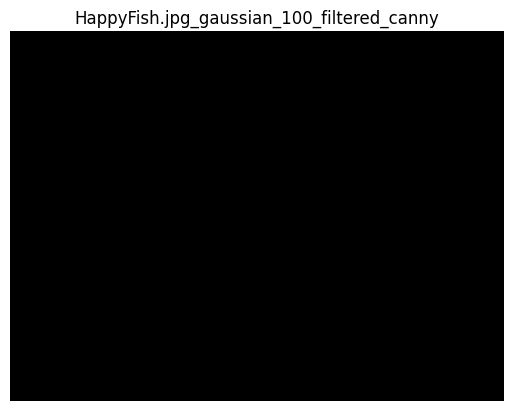

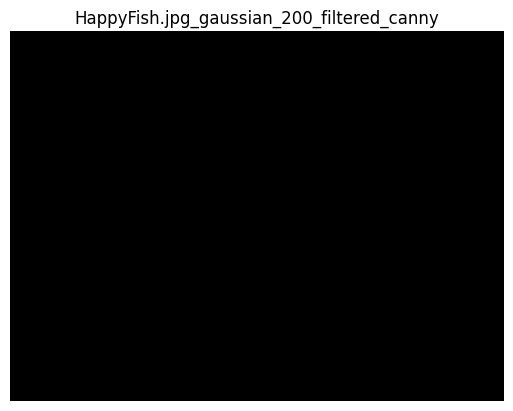

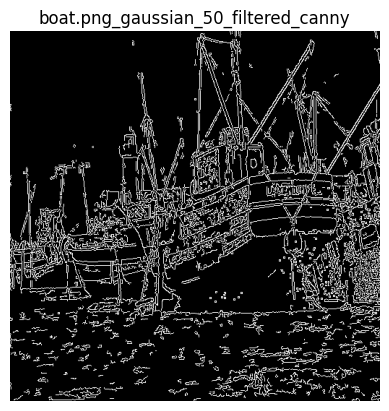

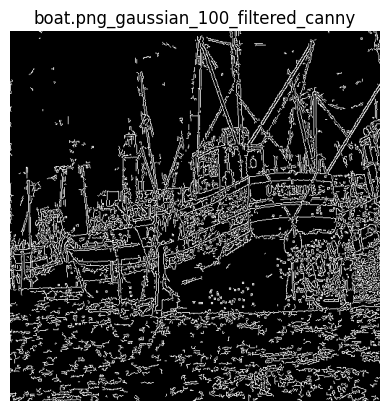

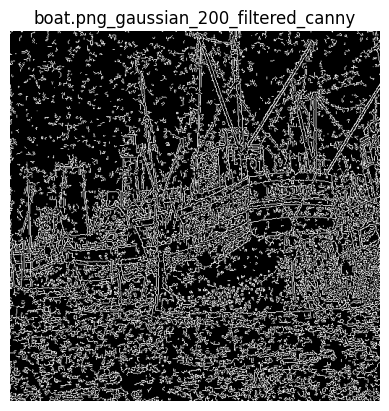

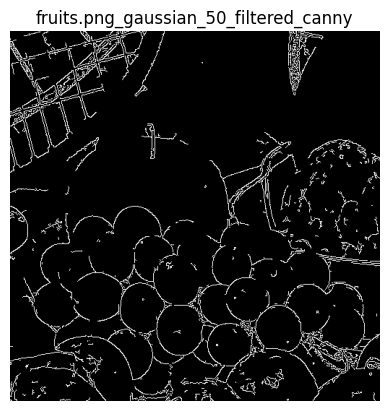

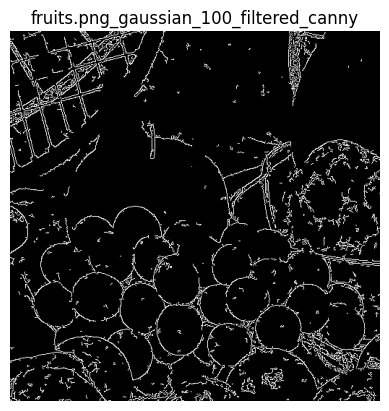

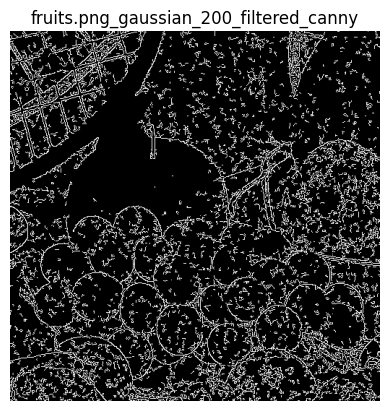

In [74]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Increasing the kernel size and maximum size allowed the filter to remove more noise, and be more effective with images with high levels of noise. Still, even in images with low levels of noise, we can notice that the filter didn't damage the images details, and the edges could still be detected with Canny.

# Poisson Noise:

In [75]:
def add_poisson_noise(image):
    noisy_image = np.random.poisson(image).astype(np.uint8)
    noisy_image = np.clip(noisy_image, 0, 255)
    return noisy_image

noisy_data_poisson = []

for index, row in original.iterrows():
    noisy_img = add_poisson_noise(row['image'])
    noisy_data_poisson.append({
        'filename': f"{row['filename']}_poisson",
        'image': noisy_img,
        'noise_type': 'poisson'
    })

noisy_poisson = pd.DataFrame(noisy_data_poisson)

In [80]:
Computational_times["Poisson"] = []
average_MSE["Poisson"] = []
average_psnr["Poisson"] = []

In [81]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 0.3009 seconds


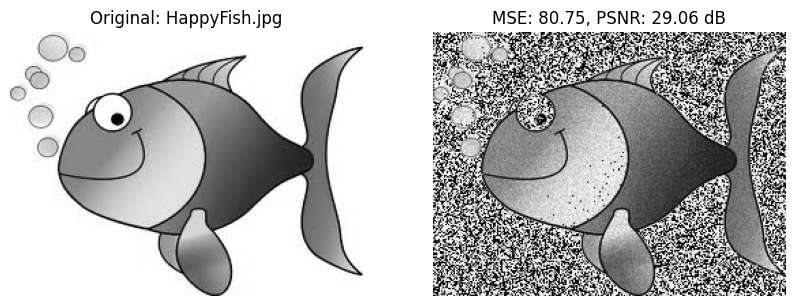

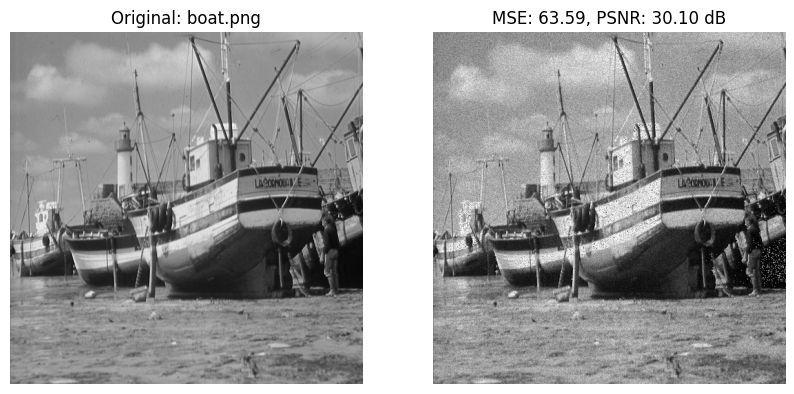

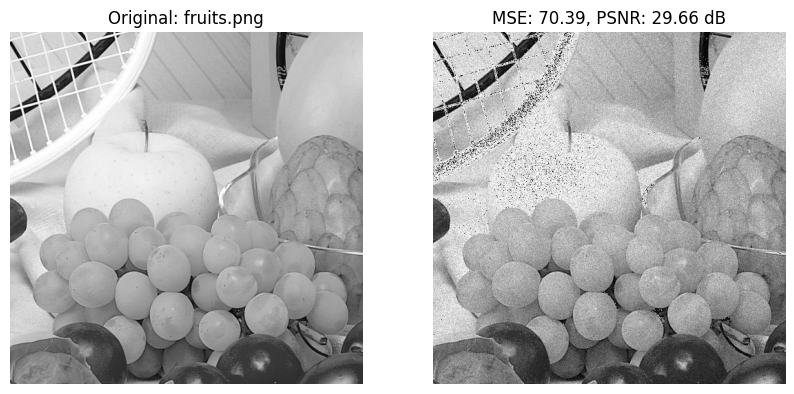

avarage mse = 71.57470733639946
avarage psnr = 29.604117696138655


In [82]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

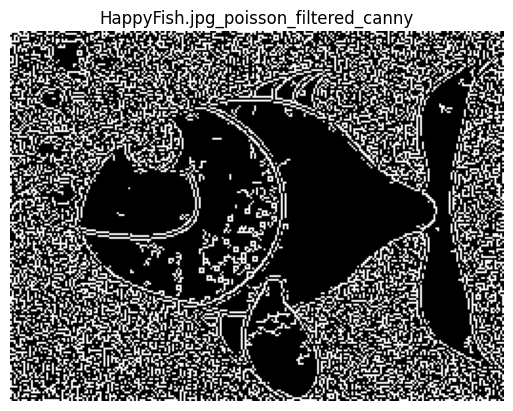

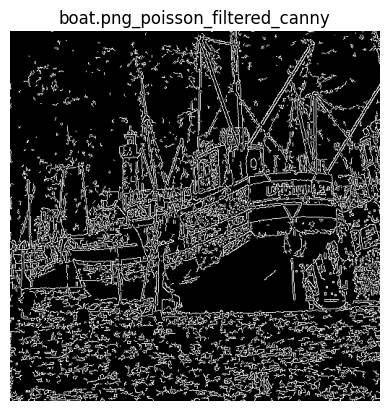

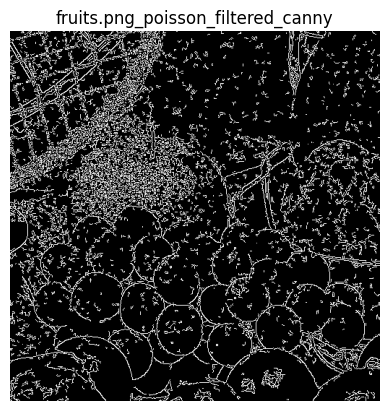

In [83]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

The poisson noise is different from the noises before, as it tends to be concentrated in one part of the image. As seen the filter did well in smooth (low detailed) parts of the images, but struggled with noise around images' details/edges. As in these parts the filter tries to not alter the images in a try to preserve the edges. But with this the filter also mistakenly preserved the noise around such edges.

In [84]:
start_time = time.time()

filtered_data = []

for index, row in noisy_poisson.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Poisson"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 1.1632 seconds


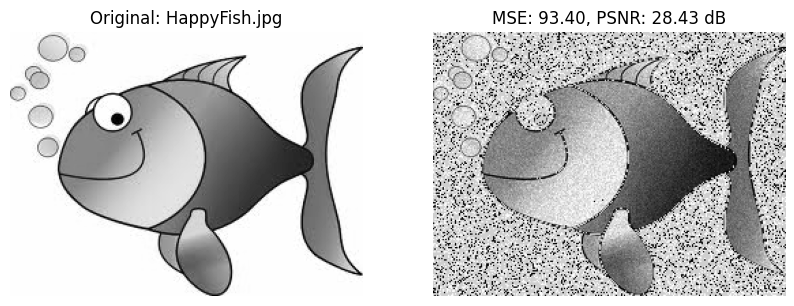

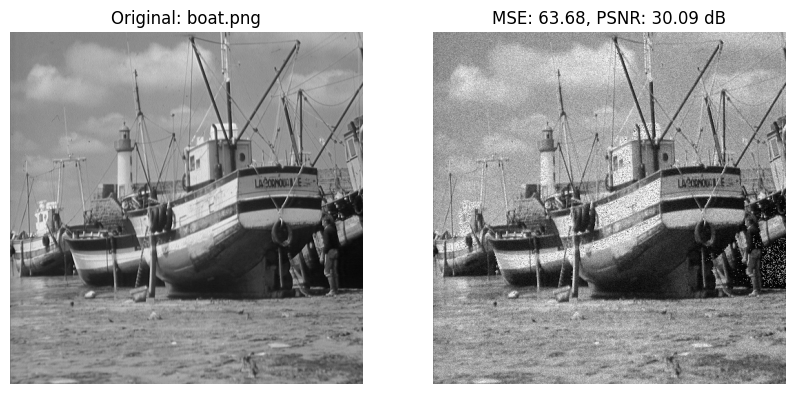

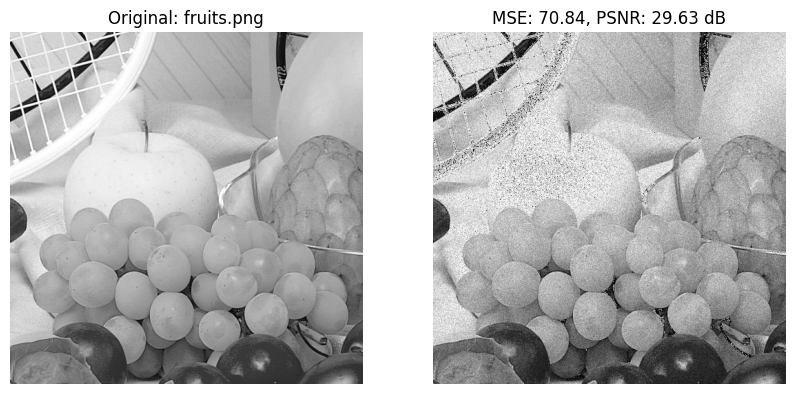

avarage mse = 75.97216947086075
avarage psnr = 29.3821042601846


In [85]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Poisson"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Poisson"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

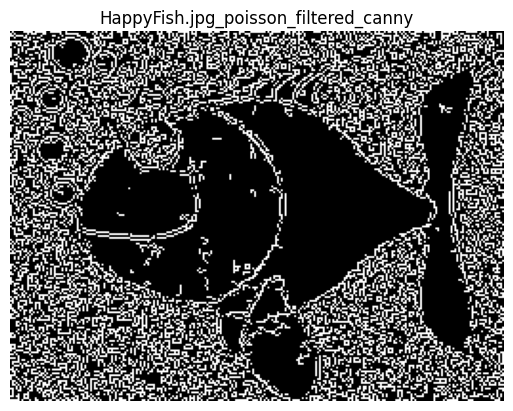

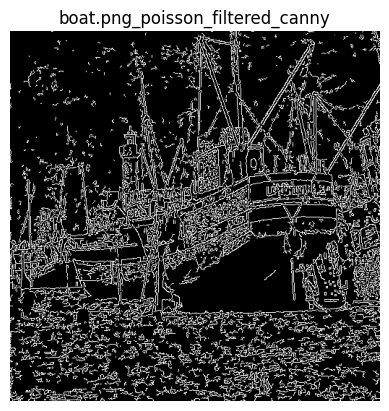

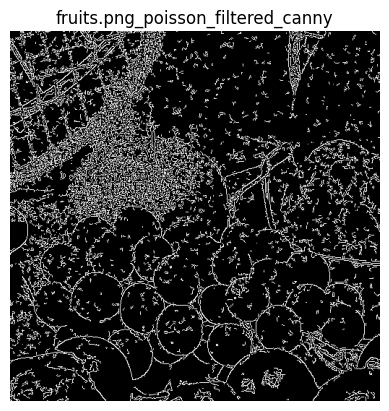

In [86]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Even with a larger kernel and a maximum kernel size. The filter still faces the same problem with noise around the edges.

# Speckle Noise:

In [114]:
def generate_speckle_noise(image_shape, mean=0, variance=0.01):
    noise = np.random.normal(mean, variance**0.5, size=image_shape)
    speckle_noise = noise * np.ones(image_shape)
    return speckle_noise

def add_speckle_noise(image, mean=0, variance=0.1):
    speckle_noise = generate_speckle_noise(image.shape, mean=mean, variance=variance)
    noisy_image = image + image * speckle_noise
    noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
    return noisy_image

speckle_variances = [0.001, 0.003, 0.005]

noisy_data_speckle = []

for index, row in original.iterrows():
    for var in speckle_variances:
        noisy_img = add_speckle_noise(row['image'], variance=var)
        noisy_data_speckle.append({
            'filename': f"{row['filename']}_speckle_{var}",
            'image': noisy_img,
            'variance': var
        })

speckle_noise = pd.DataFrame(noisy_data_speckle)

In [115]:
Computational_times["Speckle"] = []
average_MSE["Speckle"] = []
average_psnr["Speckle"] = []

In [116]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=5, max_kernel_size=7)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 1.1288 seconds


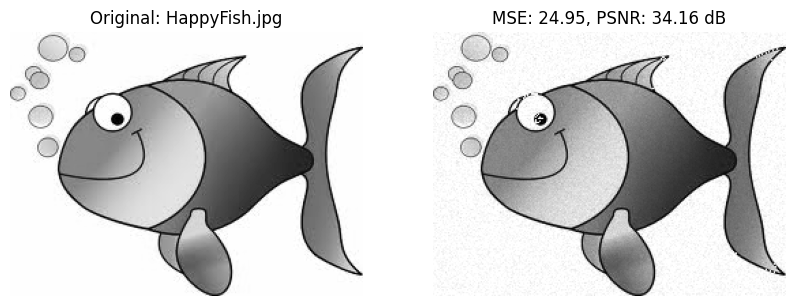

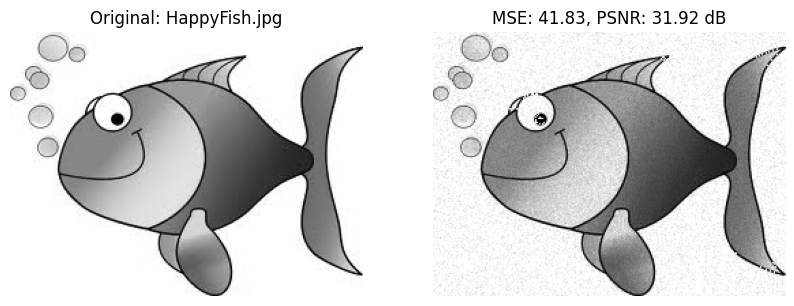

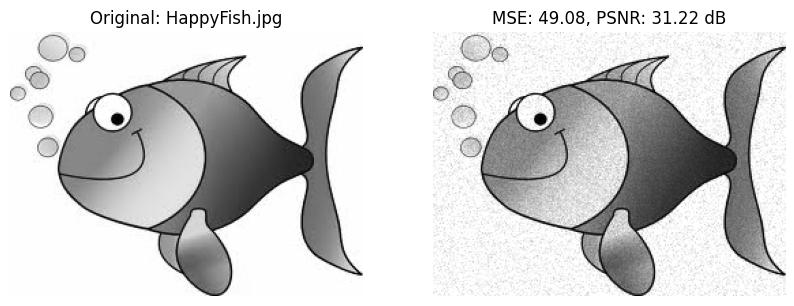

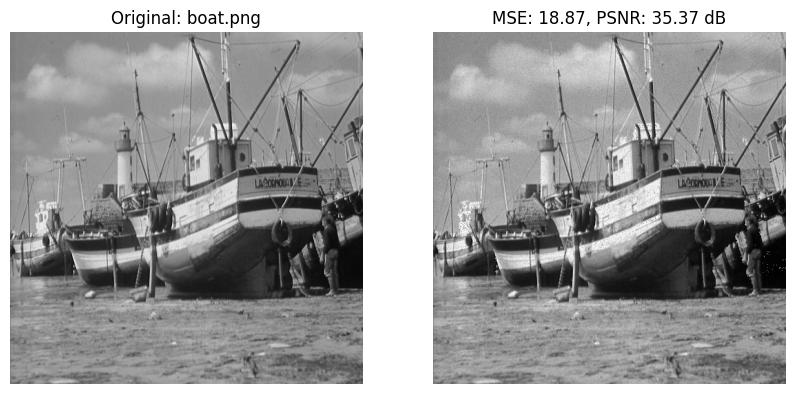

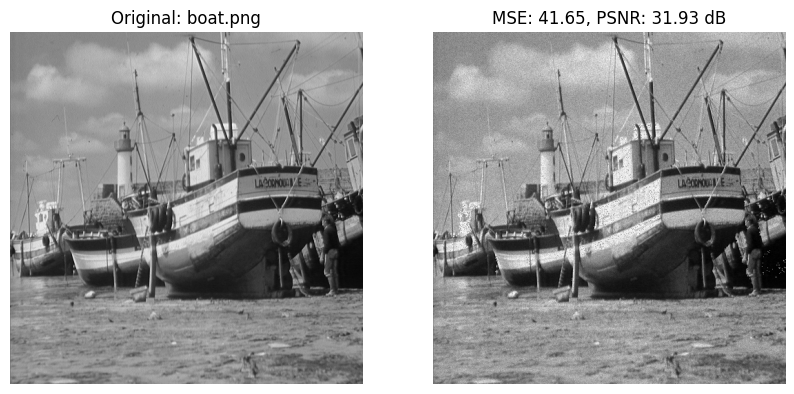

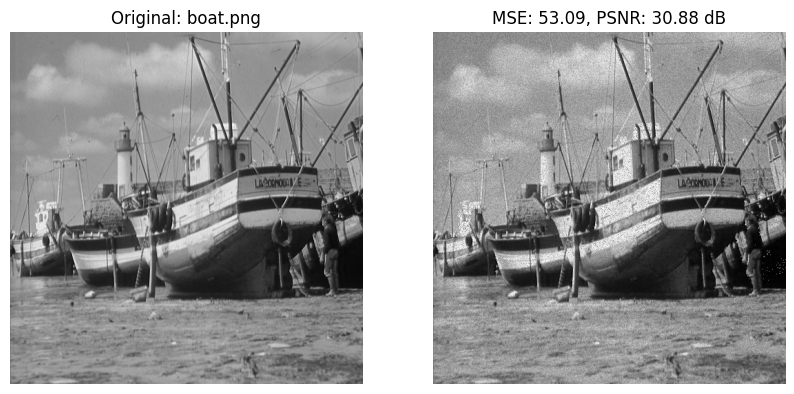

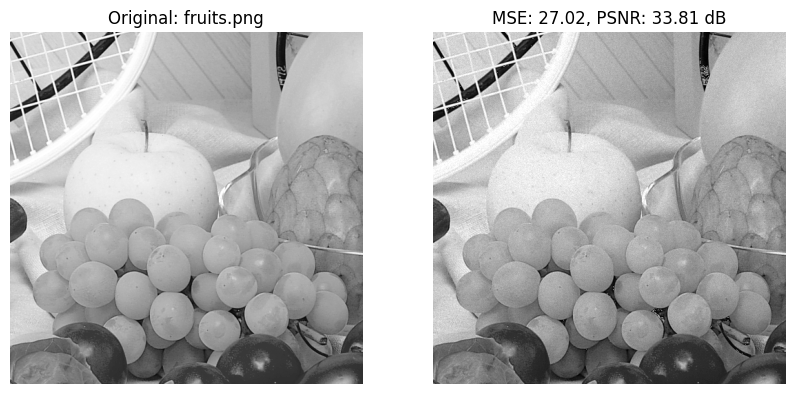

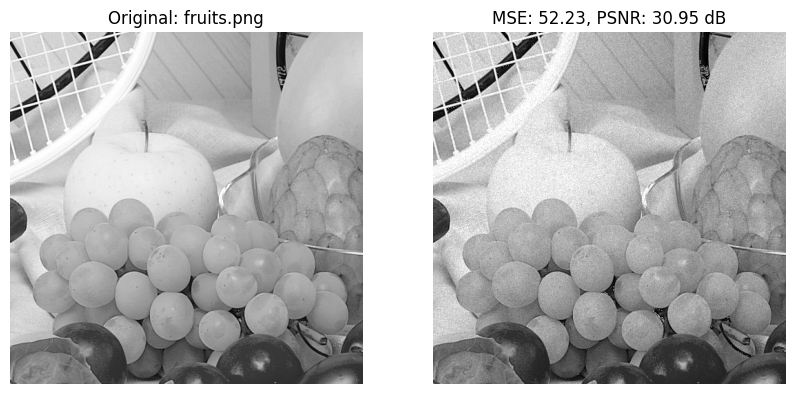

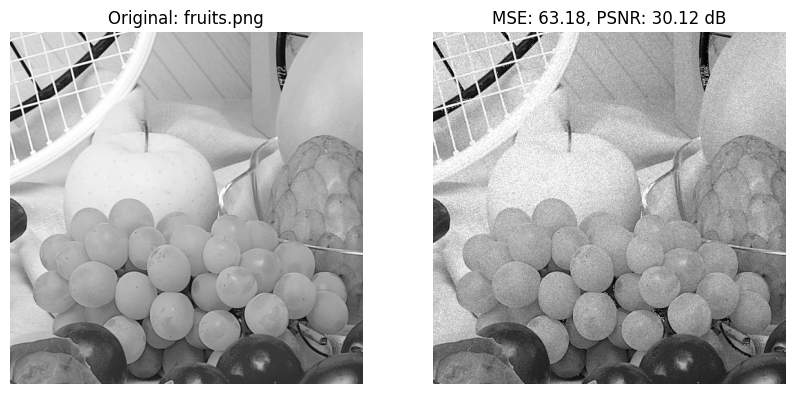

avarage mse = 41.32247565075194
avarage psnr = 32.26400787911809


In [117]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

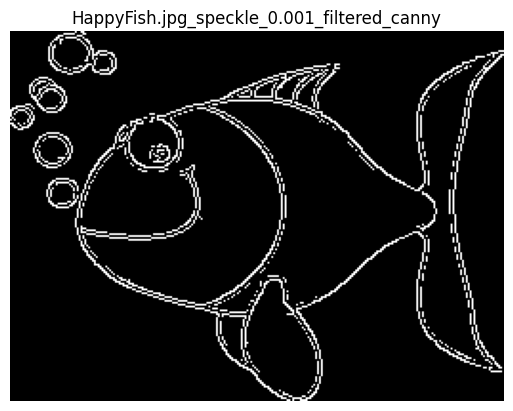

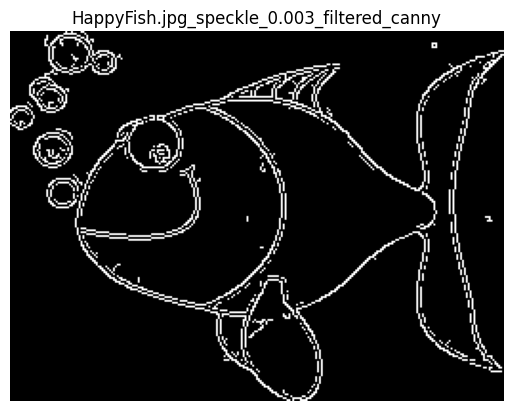

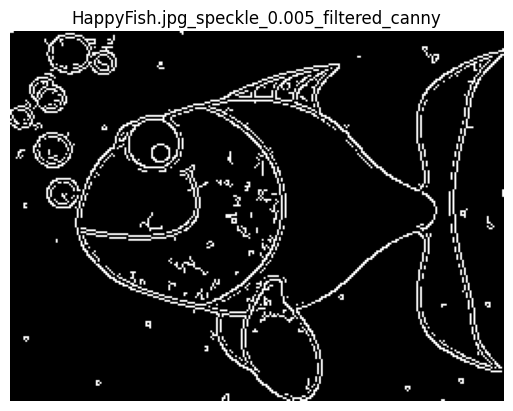

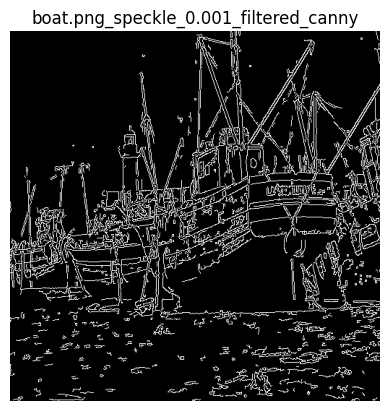

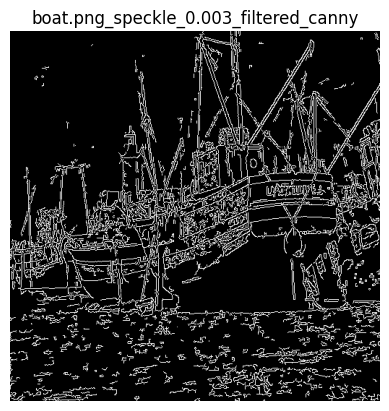

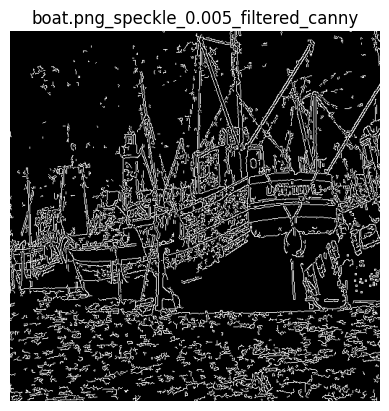

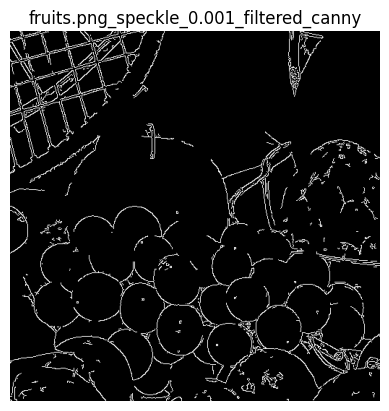

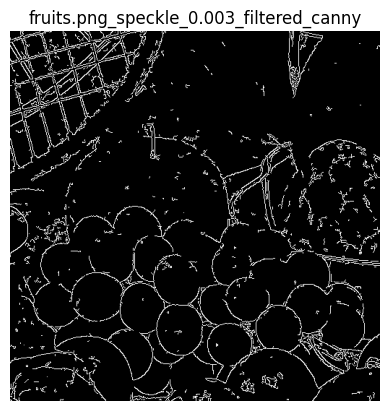

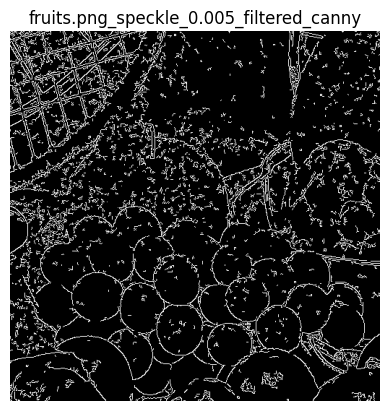

In [118]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

In [119]:
start_time = time.time()

filtered_data = []

for index, row in speckle_noise.iterrows():
    filtered_img = adaptive_median_filter(row['image'], kernel_size=11, max_kernel_size=15)

    filtered_data.append({
        'filename': f"{row['filename']}_filtered",
        'image': filtered_img,
    })

end_time = time.time()

total_time = end_time - start_time
Computational_times["Speckle"].append(total_time)
print(f"Total computational time for applying adaptive median filter: {total_time:.4f} seconds")

filtered_images = pd.DataFrame(filtered_data)

Total computational time for applying adaptive median filter: 3.7614 seconds


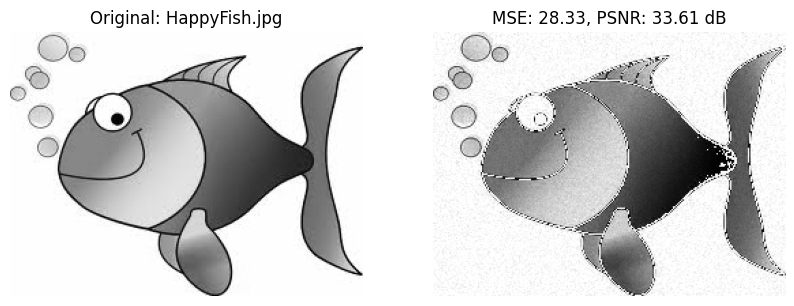

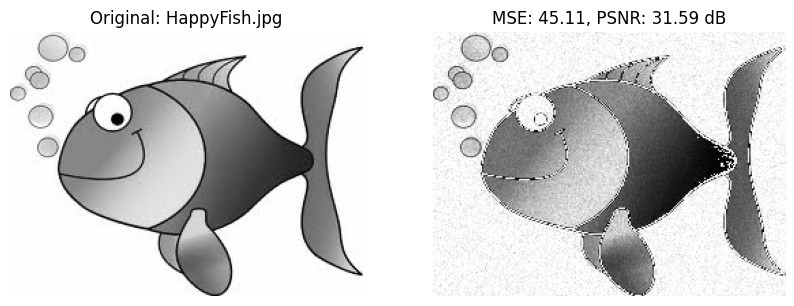

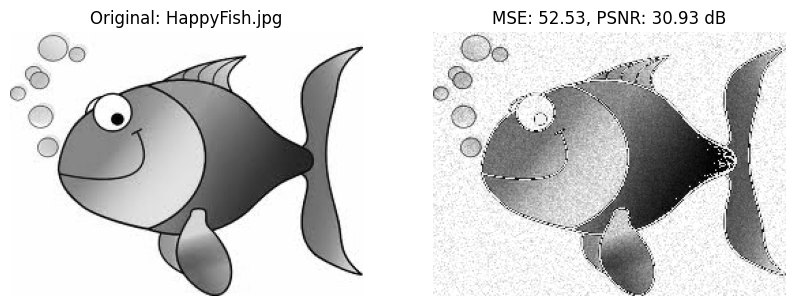

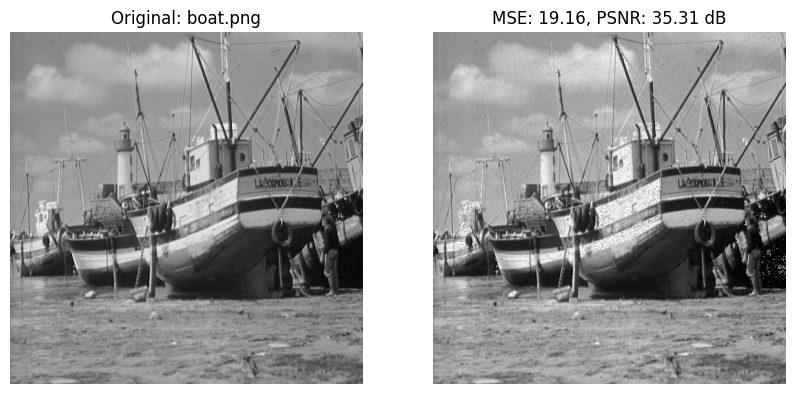

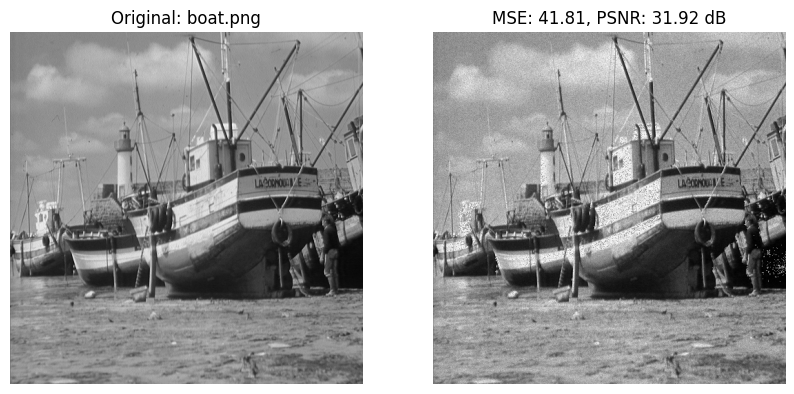

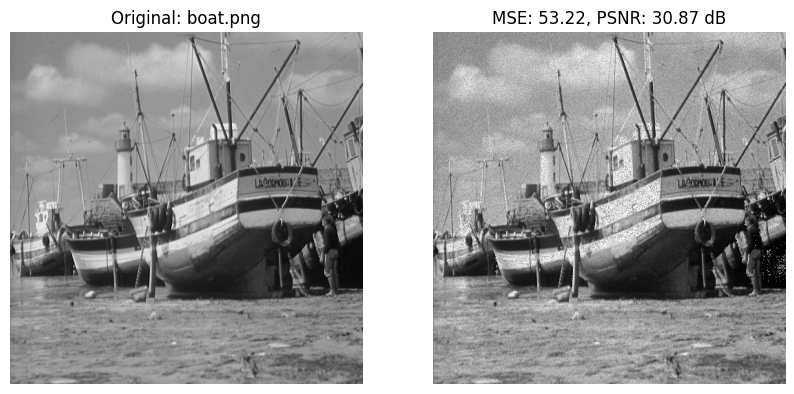

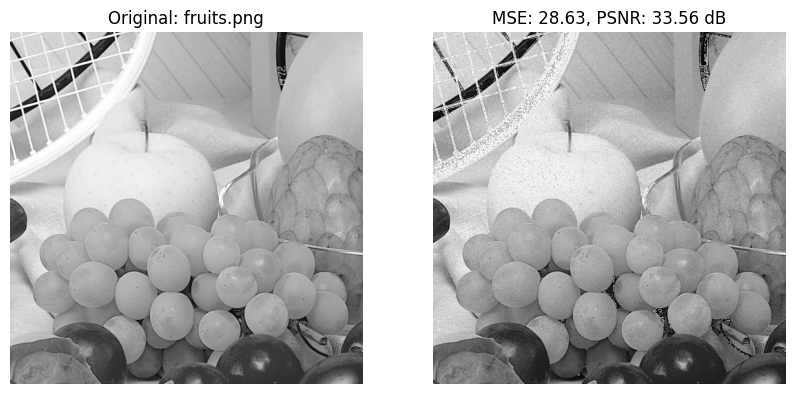

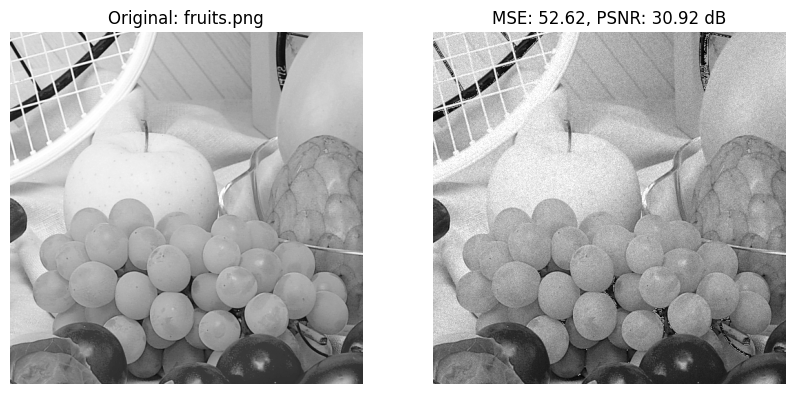

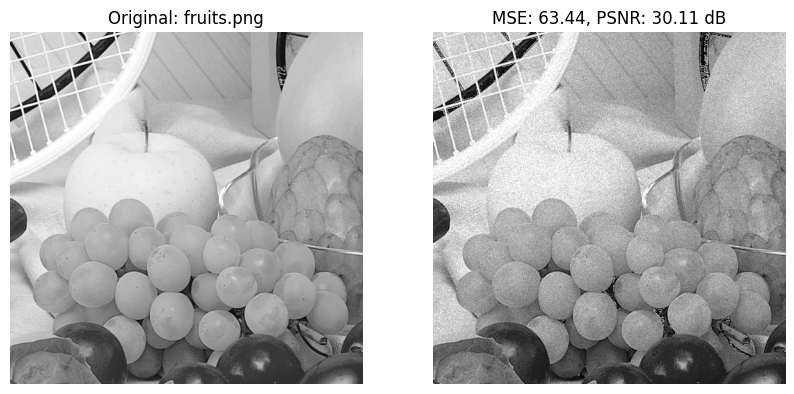

avarage mse = 42.76157426329025
avarage psnr = 32.08966366918597


In [120]:
def calculate_mse(original, filtered):
    return np.mean((original - filtered) ** 2)

def calculate_psnr(mse, max_pixel=255.0):
    return 20 * np.log10(max_pixel) - 10 * np.log10(mse) if mse > 0 else float('inf')

counter = 0
mse_sum = 0
psnr_sum = 0

for index, row in original.iterrows():
    original_img = row['image']

    filtered_img_rows = filtered_images[filtered_images['filename'].str.contains(row['filename'])]

    for _, filtered_row in filtered_img_rows.iterrows():
        filtered_img = filtered_row['image']

        mse = calculate_mse(original_img, filtered_img)
        mse_sum += mse
        psnr = calculate_psnr(mse)
        psnr_sum += psnr

        counter +=1

        fig, axes = plt.subplots(1, 2, figsize=(10, 5))

        axes[0].imshow(original_img, cmap='gray')
        axes[0].set_title(f"Original: {row['filename']}")
        axes[0].axis('off')

        axes[1].imshow(filtered_img, cmap='gray')
        axes[1].set_title(f"MSE: {mse:.2f}, PSNR: {psnr:.2f} dB")
        axes[1].axis('off')

        plt.show()

avrg_mse = mse_sum/counter
average_MSE["Speckle"].append(avrg_mse)
print(f"avarage mse = {avrg_mse}")

avrg_psnr = psnr_sum/counter
average_psnr["Speckle"].append(avrg_psnr)
print(f"avarage psnr = {avrg_psnr}")

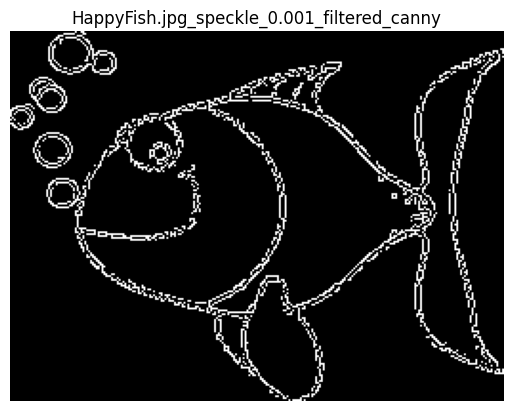

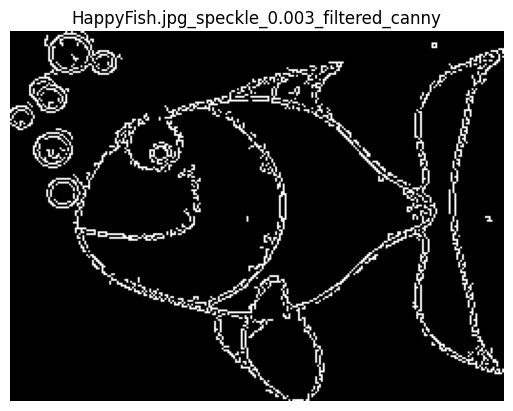

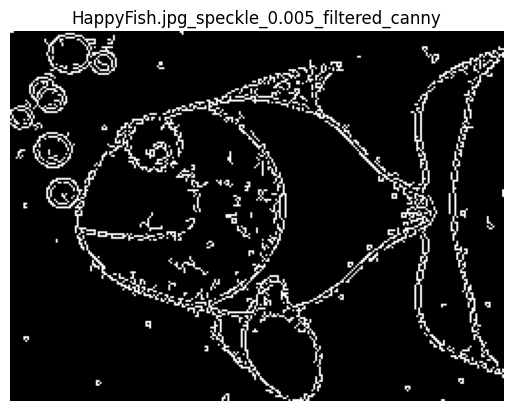

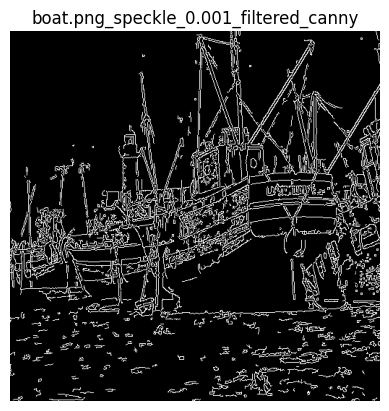

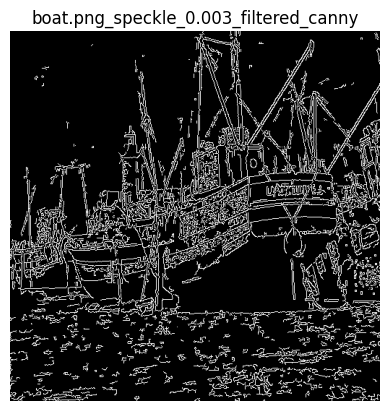

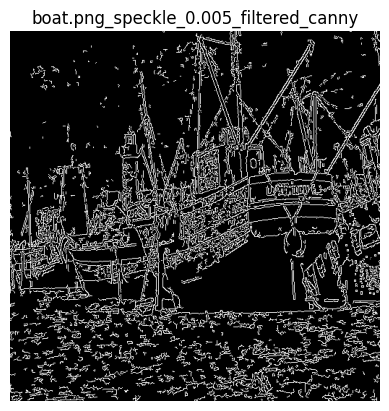

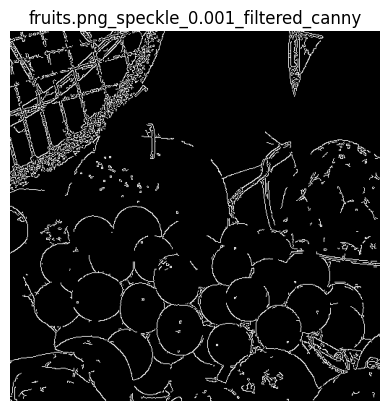

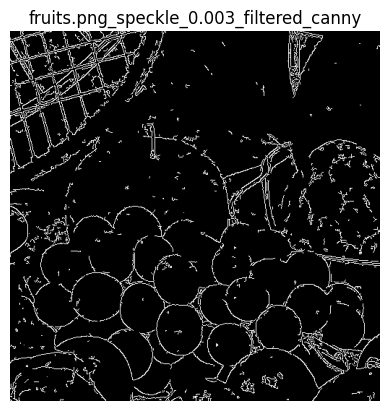

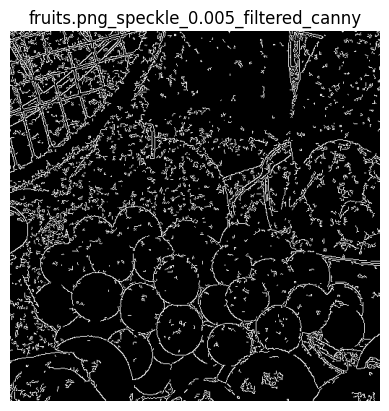

In [121]:
def apply_canny_edge(image, threshold1=100, threshold2=200):
    edges = cv2.Canny(image, threshold1, threshold2)
    return edges

canny_data = []

for index, row in filtered_images.iterrows():
    canny_edges = apply_canny_edge(row['image'], threshold1=100, threshold2=200)
    canny_data.append({
        'filename': f"{row['filename']}_canny",
        'image': canny_edges
    })

canny_edges_df = pd.DataFrame(canny_data)

for index, row in canny_edges_df.iterrows():
    plt.imshow(row['image'], cmap='gray')
    plt.title(row['filename'])
    plt.axis('off')
    plt.show()

Same results as with Gaussian noise. The adaptive median filter did well with speckle noise, removing it while preserving images' details.

# Results:

In [122]:
comp_times_df = pd.DataFrame(Computational_times, index=['kernel=5, max=7', 'kernel=11, max=15']).T
mse_df = pd.DataFrame(average_MSE, index=['kernel=5, max=7', 'kernel=11, max=15']).T
psnr_df = pd.DataFrame(average_psnr, index=['kernel=5, max=7', 'kernel=11, max=15']).T

In [123]:
print("Computational Times:")
comp_times_df.style.set_caption("Computational Times").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Computational Times:


,"kernel=5, max=7","kernel=11, max=15"
Salt and Pepper,0.854676,3.445588
Gaussian,0.977242,4.039376
Poisson,0.300927,1.163186
Speckle,1.128786,3.761388


With a larger initial kernel and maximum kernel size, the filter did more iterations on the same pixel, compared to a smaller kernel and maximum kernel size. Hence why the computational time is of course longer.

In [124]:
print("Average MSEs:")
mse_df.style.set_caption("Average MSEs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average MSEs:


,"kernel=5, max=7","kernel=11, max=15"
Salt and Pepper,7.619199,8.671042
Gaussian,87.564520,87.585999
Poisson,71.574707,75.972169
Speckle,41.322476,42.761574


The average MSE didn't change with bigger kernel and maximum kernel sizes. As in all cases the filter struggled with noise around images' details/edges. On the contrary, a smaller kernel did slightly better, because it was able to go closer to the edges without crossing them (including them inside its kernel).

In [125]:
print("Average PSNRs:")
psnr_df.style.set_caption("Average PSNRs").set_table_styles([{'selector': 'th', 'props': [('border', '1px solid black')]}])

Average PSNRs:


,"kernel=5, max=7","kernel=11, max=15"
Salt and Pepper,41.873492,40.188846
Gaussian,28.943352,28.942378
Poisson,29.604118,29.382104
Speckle,32.264008,32.089664


Same explination as before, as PSNR goes along with the MSE.